In [1]:
from otrpca import otrpca
from t_tools import *
import numpy as np
import matplotlib.pyplot as plt
from skimage.exposure import rescale_intensity

In [2]:
#to generate an example for the otrpca algorithm, we will use this function that  
#takes a tensor and stacks T copies of it along the 2nd (index 1) dimension
def stacker(L_0, T):
    
    L_0_expanded = np.expand_dims(L_0, 1)
    stacked_dims = np.array(L_0_expanded.shape)
    stacked_dims[1] = T
    L_0_stacked = np.empty(stacked_dims, dtype = complex)

    #slices from min to max for every dimension
    all_slice = [slice(0, stacked_dims[i]) for i in range(len(stacked_dims))]
    
    #for each i (ranging up to T) insert a copy
    for i in range(T):
        all_slice[1] = slice(i,i+1) 
        L_0_stacked[tuple(all_slice)] = L_0_expanded
        
    return(L_0_stacked)

In [3]:
#now we will generate a low rank tensor L_0
n = 30    #size of each dimension other than the 2nd dimension (indexed 1, 4 dimension tensor)
T = 10    #size of the 2nd dimensions (indexed 1)
rank = 3  #rank of the tensor

#generate problem: recover L_0 (and C_0) when given M_0
A = np.random.normal(0,1/n,(n,rank,n))
B = np.random.normal(0,1/n,(rank,n,n))
L_0 = stacker(t_prod(A, B), T)

In [4]:
#generate an example problem: recover L_0 (and C_0) when given M_0
rho = .05  #proportion of corrupted entries
var = .5   #variance of the normal distribution generating the noise
def add_noise(L_0, rho, var):
    S_0 = np.random.binomial(1,rho, L_0.shape)          #affected entries
    N   = np.random.normal(0, var, L_0.shape)           #noise into affected entries
    C_0 = S_0 * N

    return(C_0 + L_0, C_0)

M_0, C_0 = add_noise(L_0, rho, var)

In [5]:
#apply algorithm
L, C = otrpca(M_0, initial_A='random_normal', iterations=2)

In [6]:
#test effectiveness
print(np.linalg.norm(L - L_0)/np.linalg.norm(L_0))

0.09454741353337189


In [7]:
#lets try some real data
cloudy = np.reshape(np.loadtxt('cloudy.csv', delimiter=','), (410, 18, 565, 3))

In [8]:
#we will use this to make it easier to view the data
def plot(image, dpi_=150):
    img = np.real(image.copy())
    for b in range(img.shape[2]):
        tmp = img[:,:,b]
        pl, pu = np.percentile(tmp[np.isfinite(tmp)], (1, 99)) # 1-99% cut-off
        img[:,:,b] = rescale_intensity(img[:,:,b], in_range=(pl, pu), out_range=(0., 1.))

    plt.figure(dpi = dpi_)
    plt.imshow(img, interpolation='bilinear')
    plt.tick_params(axis='both', which='both', bottom= False, top=False, labelbottom=False, right=False, left=False, labelleft=False)
    plt.tight_layout()

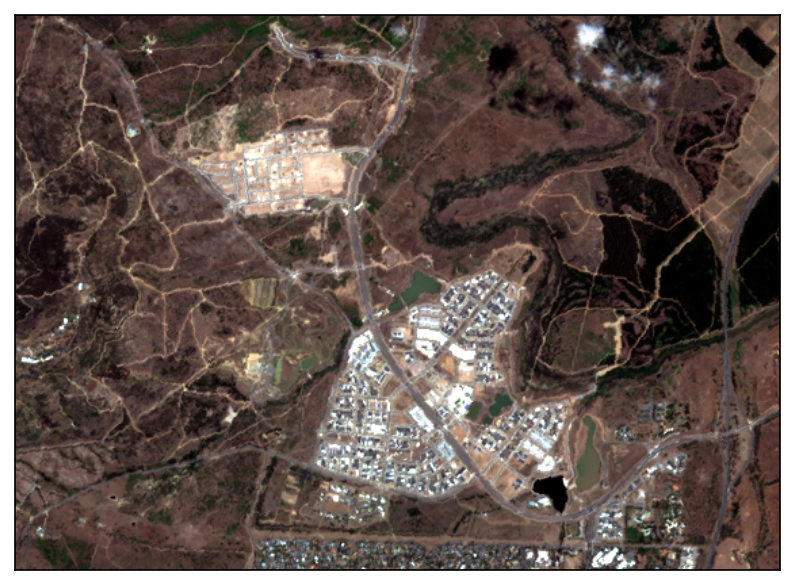

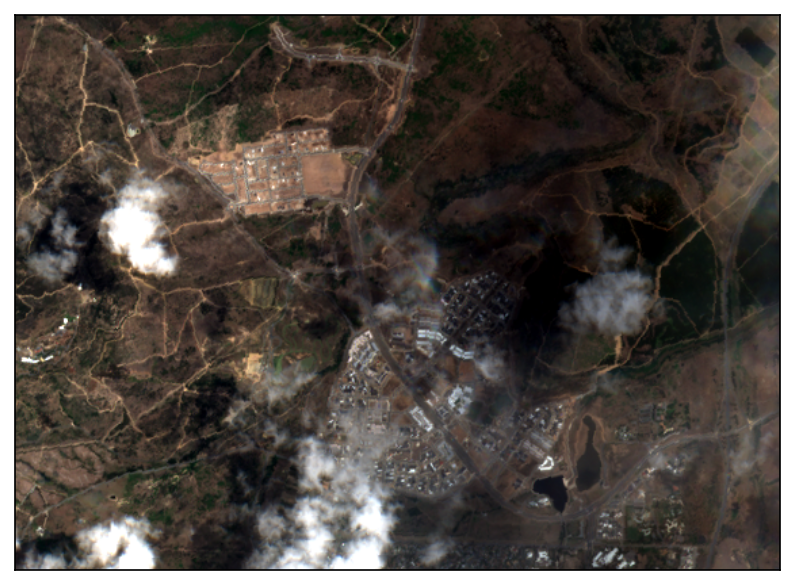

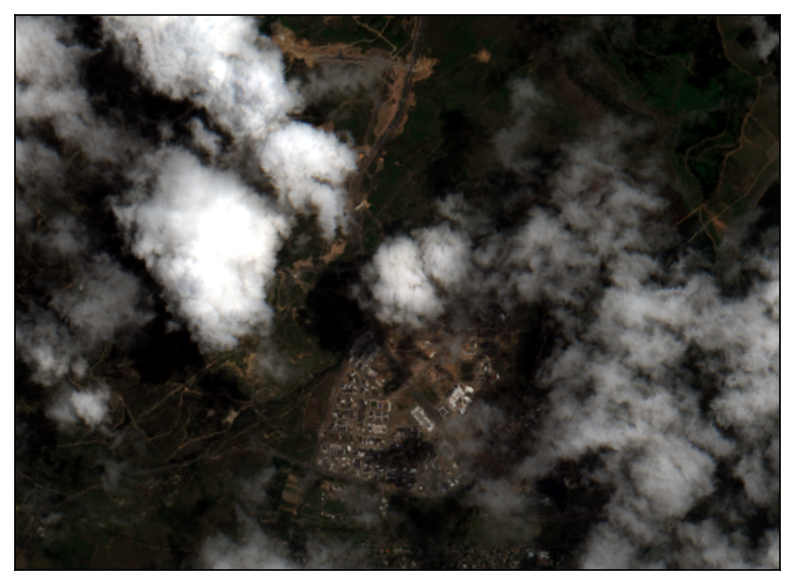

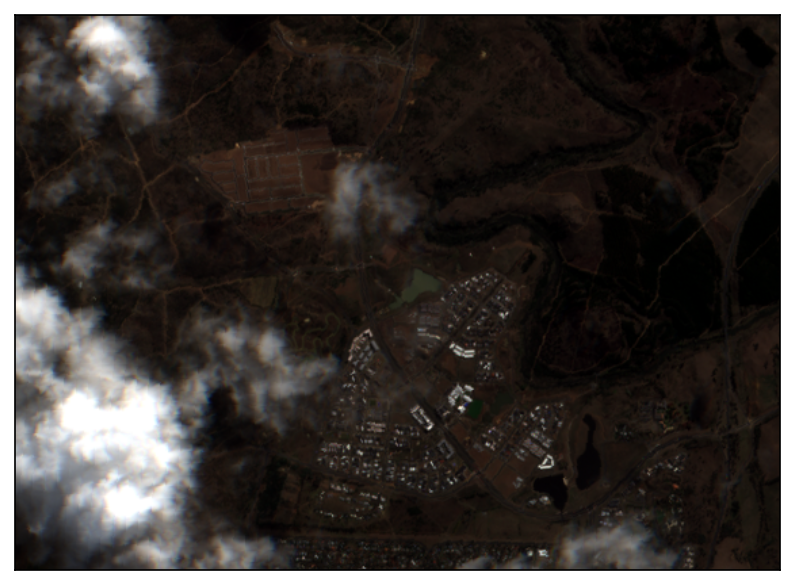

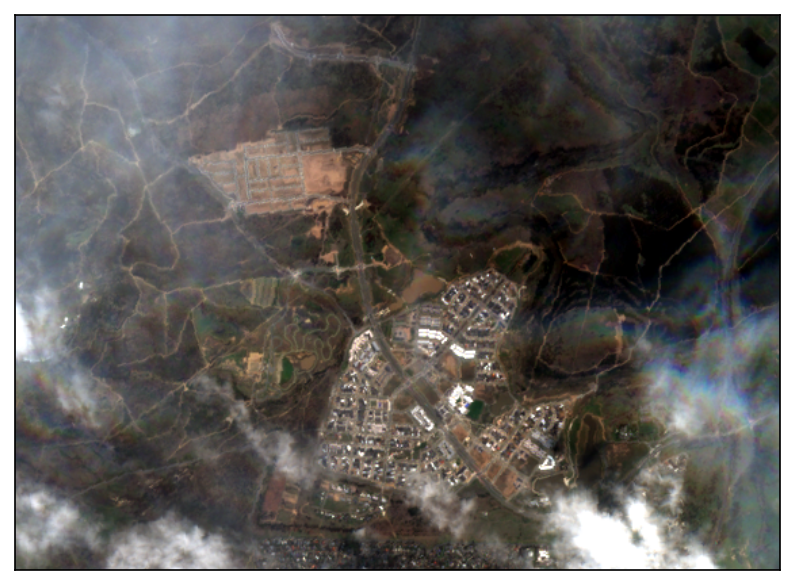

...

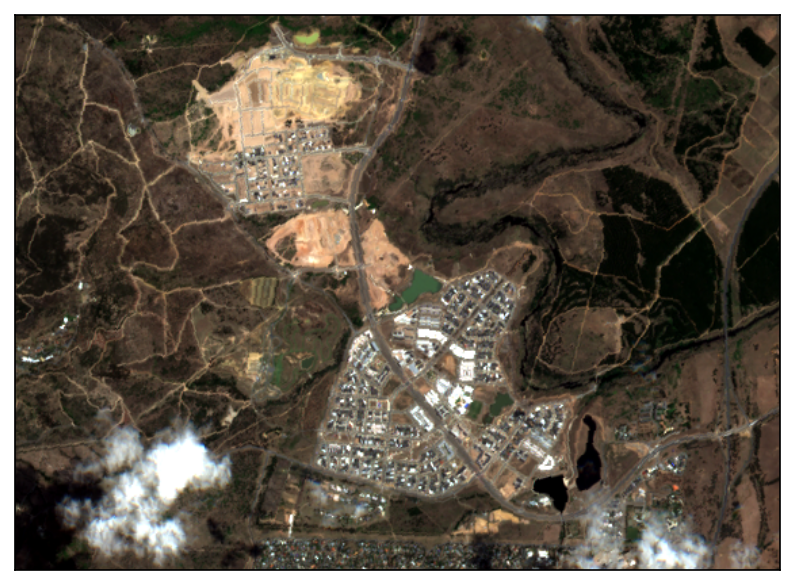

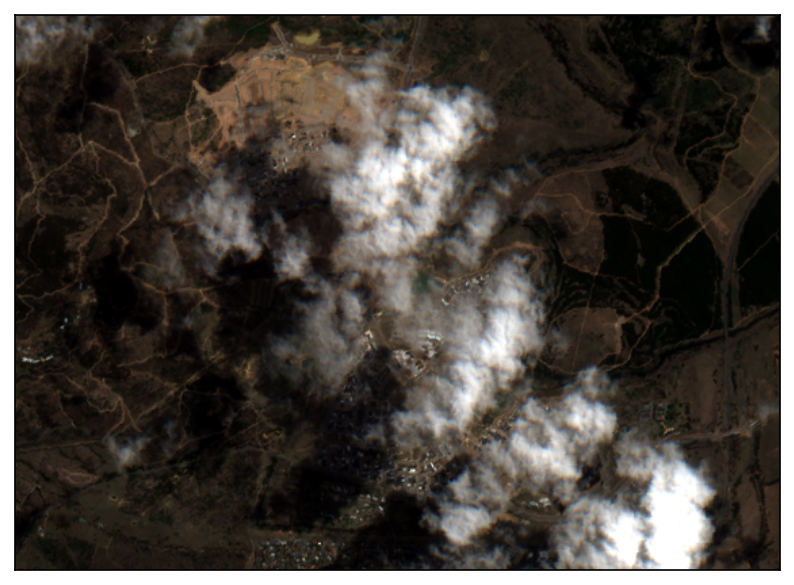

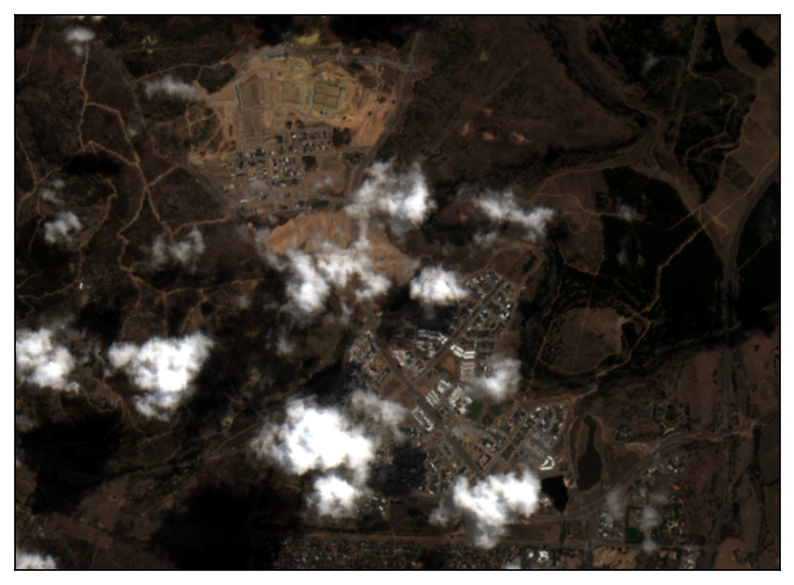

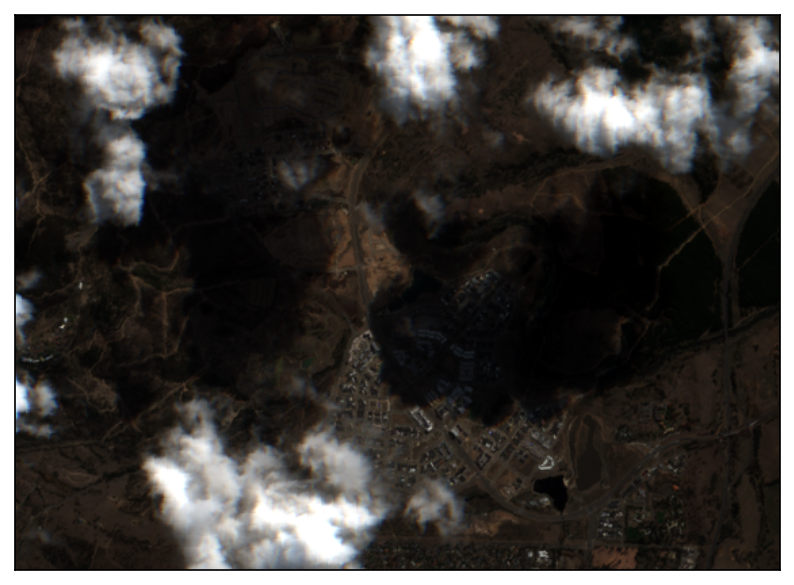

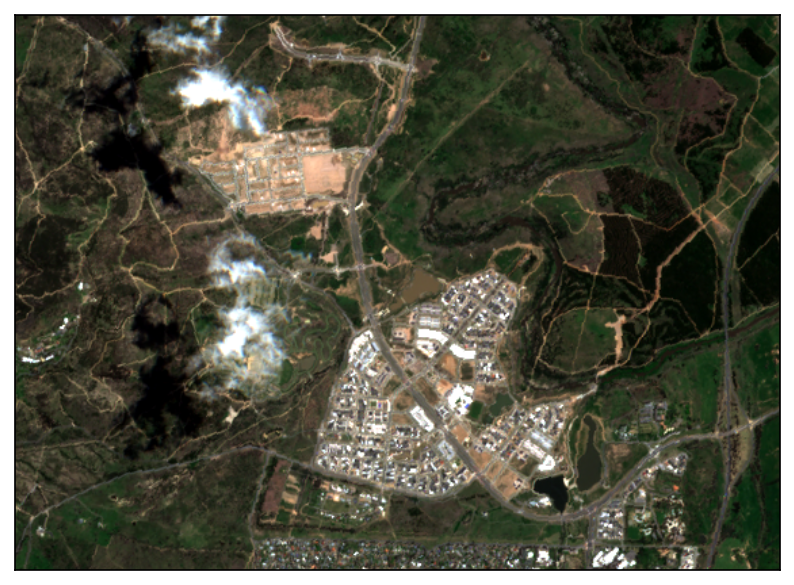

In [9]:
#damn clouds in the way (images are stacked along second (indexed 1) axis)
for i in range(cloudy.shape[1]):
    plot(cloudy[:,i,:,:])

In [10]:
#apply the algorithm
L, C = otrpca(cloudy, rank=3, iterations=2)

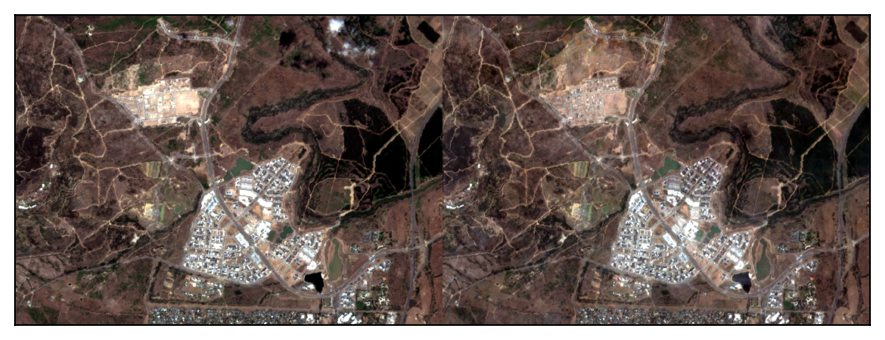

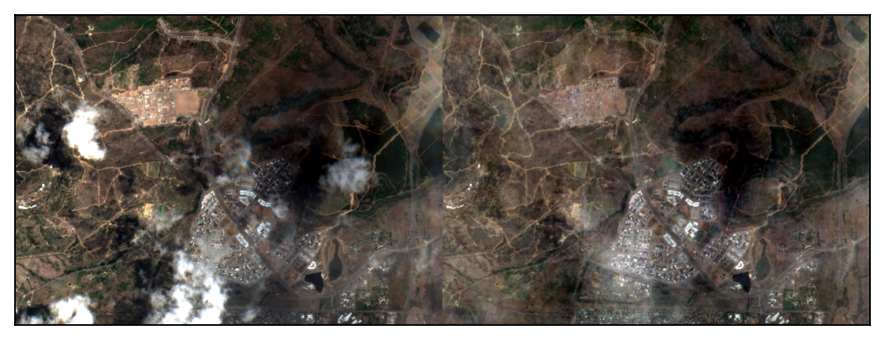

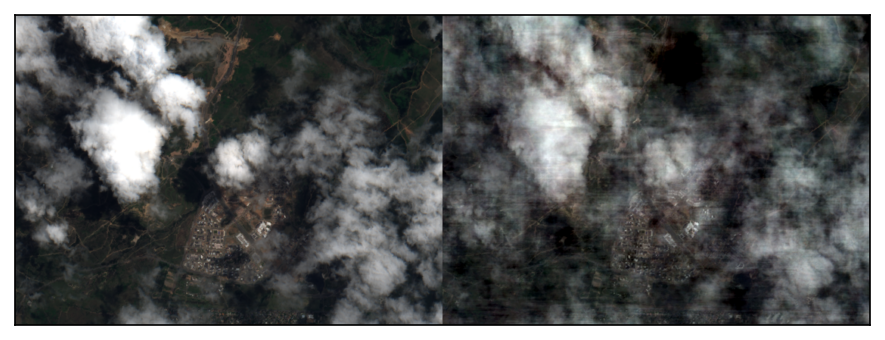

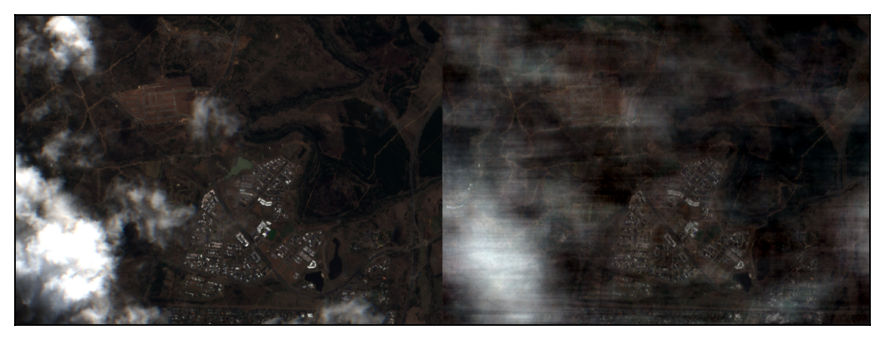

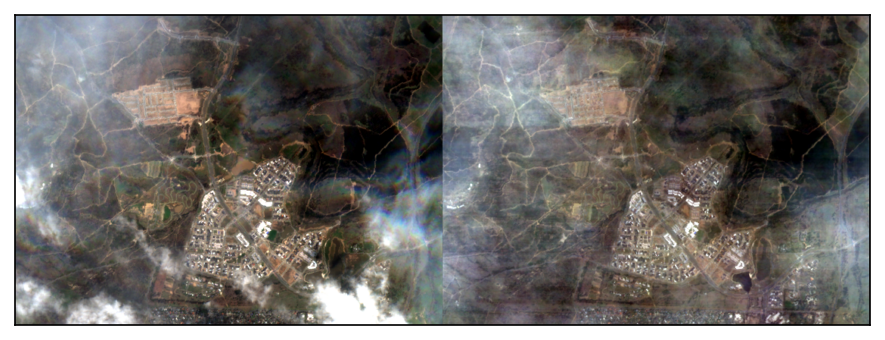

...

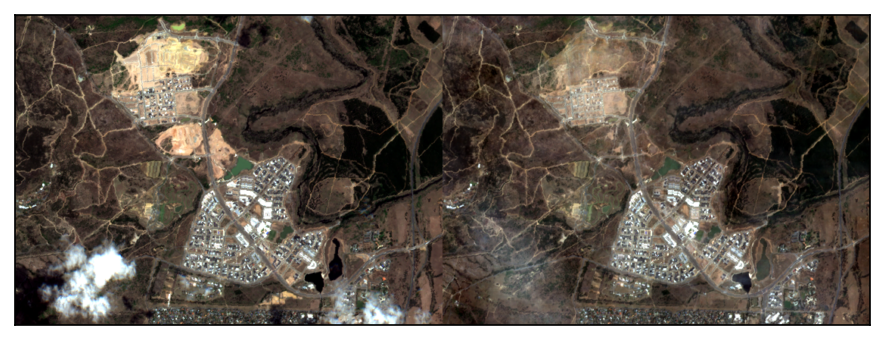

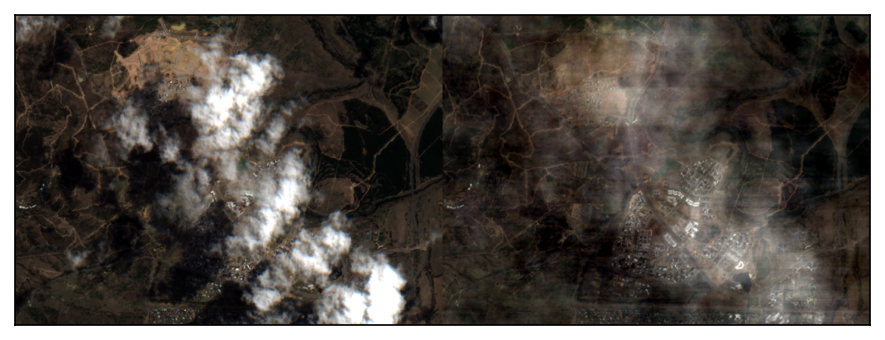

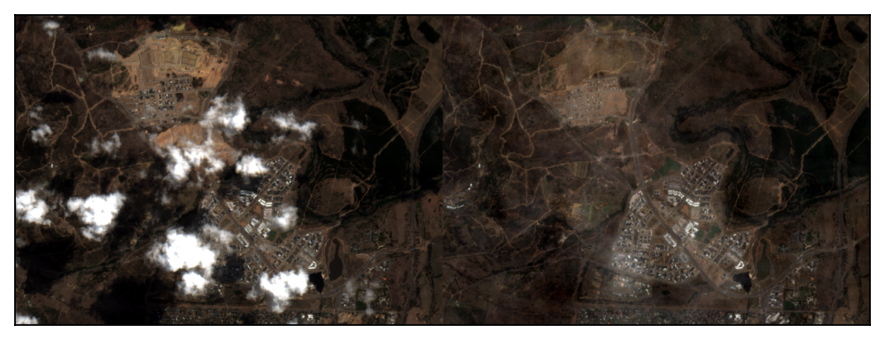

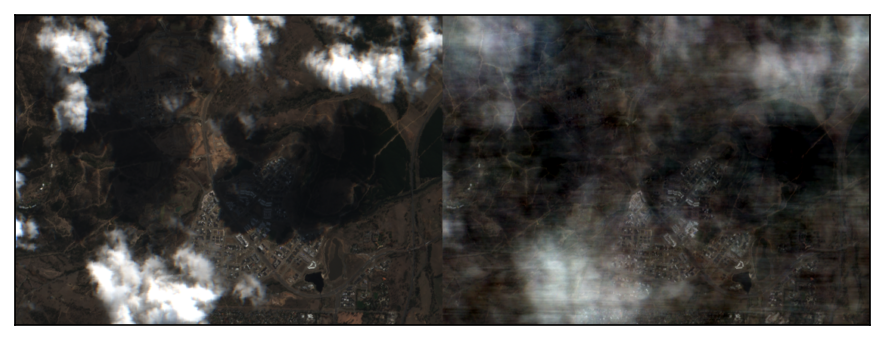

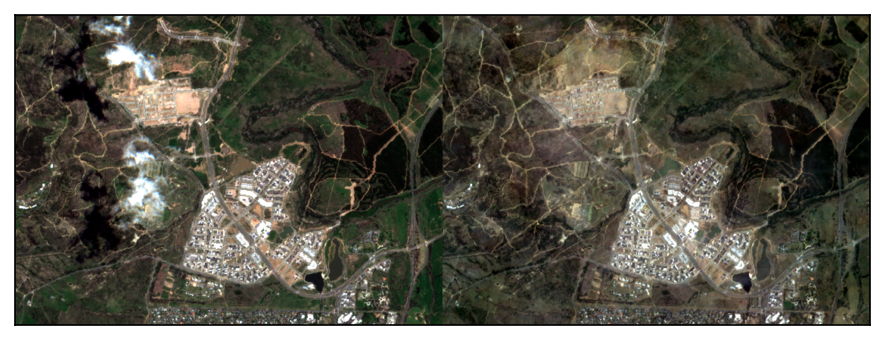

In [11]:
#see how it worked
for i in range(cloudy.shape[1]):
    plot(np.concatenate((cloudy[:,i,:,:], L[:,i,:,:]), axis = 1))

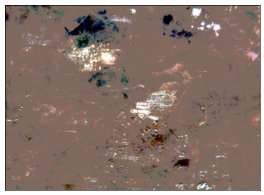

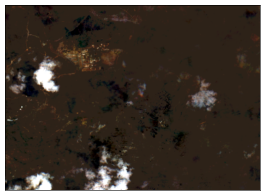

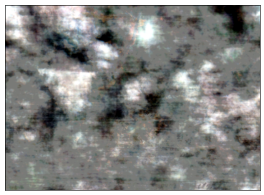

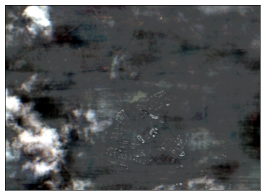

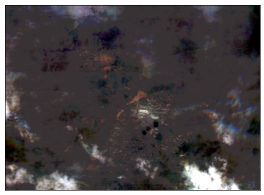

...

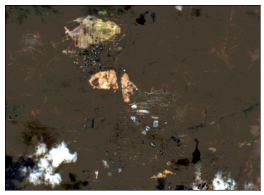

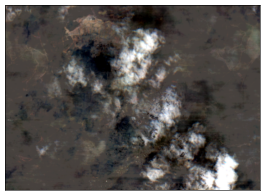

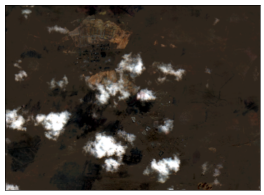

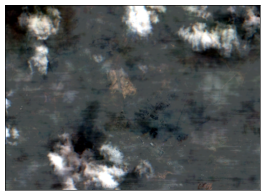

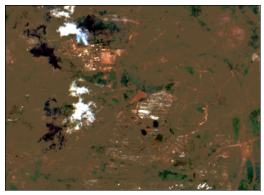

In [12]:
#here's what was removed
for i in range(cloudy.shape[1]):
    plot(C[:,i,:,:], 50)